# 03 - SnakeCLEF - Exploration of Images in the Training Dataset

The notebook contains:
* examples of noisy data from Flickr source,
* estimating confidence interval of noisy images in Flickr using Student's t-distribution.

In [1]:
import os

os.chdir('..')

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from src.core import data
from src.utils import visualization as viz


DATA_DIR = 'data/snake_clef2021_dataset/'
TRAIN_SET_DIR = 'train/'

In [3]:
train_df = pd.read_csv(DATA_DIR + 'SnakeCLEF2021_train_metadata_PROD.csv')

train_df['source'].value_counts()

inaturalist    277025
herpmapper      58351
flickr          50630
Name: source, dtype: int64

## Image Examples

In [4]:
dataset = data.ImageDataset(
    train_df[train_df['source'] != 'flickr'], path=DATA_DIR + TRAIN_SET_DIR,
    img_path_col='image_path', label_col='binomial')

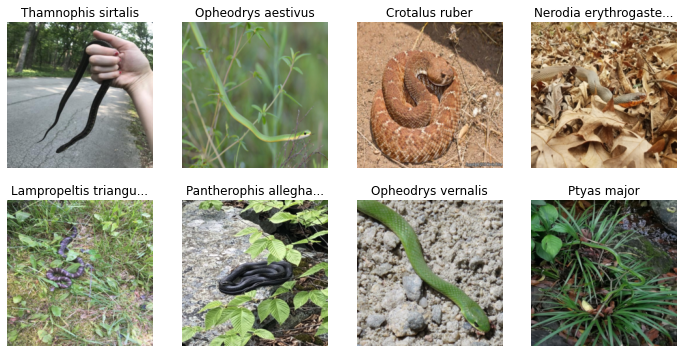

In [5]:
idx = [157603, 171024, 320505, 24289, 148490, 1768, 127277, 180460]
dataset.show_items(idx, ncols=4)

In [6]:
for i, _idx in enumerate(idx):
    img, label = dataset.get_item(_idx)
    img = img.resize((224, 224))
    filename = label.replace(' ', '_').lower()
    img.save(f'figures/snake_examples/{filename}.png')

## Noisy Samples from Flickr

In [4]:
len(train_df['binomial'].drop_duplicates())

772

In [5]:
normal_ids = train_df.loc[(train_df['source'] != 'flickr'), 'class_id'].drop_duplicates()

flickr_valid_df = train_df[(train_df['source'] == 'flickr') & (train_df['subset'] == 'val')]
extra_classes_df = flickr_valid_df[~flickr_valid_df['class_id'].isin(normal_ids)]

extra_classes_df

,binomial,country,continent,genus,family,UUID,source,subset,class_id,image_path
348247,Oligodon trilineatus,Argentina,South America,Oligodon,Colubridae,43429c2095434e7db77ecbc0ac4161b6,flickr,val,493,flickr/43429c2095434e7db77ecbc0ac4161b6.jpg
350643,Echinanthera melanostigma,unknown,unknown,Echinanthera,Colubridae,d2b3408d3a2a432b9da78223b4339d51,flickr,val,246,flickr/d2b3408d3a2a432b9da78223b4339d51.jpg
351417,Oligodon trilineatus,Thailand,Asia,Oligodon,Colubridae,5078422f756044a7ac27b6957380085b,flickr,val,493,flickr/5078422f756044a7ac27b6957380085b.jpg
352755,Morelia carinata,unknown,unknown,Morelia,Pythonidae,159138daebb548eeb772f0b03726be9e,flickr,val,452,flickr/159138daebb548eeb772f0b03726be9e.jpg
354882,Bolyeria multocarinata,unknown,unknown,Bolyeria,Bolyeriidae,302c0b63d50a4c959a8088f533ecfb40,flickr,val,77,flickr/302c0b63d50a4c959a8088f533ecfb40.jpg
365197,Echinanthera melanostigma,unknown,unknown,Echinanthera,Colubridae,9e0972ff51384db9a29cbe0545abd2d0,flickr,val,246,flickr/9e0972ff51384db9a29cbe0545abd2d0.jpg
365626,Oligodon trilineatus,Thailand,Asia,Oligodon,Colubridae,5da53846b64c4acd8781a4cef44ffe10,flickr,val,493,flickr/5da53846b64c4acd8781a4cef44ffe10.jpg
372074,Morelia carinata,United States of America,North America,Morelia,Pythonidae,a5ff2d65c279436091c993bb5a429440,flickr,val,452,flickr/a5ff2d65c279436091c993bb5a429440.jpg
372381,Oligodon trilineatus,unknown,unknown,Oligodon,Colubridae,f85e17e3026b4fcebedabf2dab971ef6,flickr,val,493,flickr/f85e17e3026b4fcebedabf2dab971ef6.jpg
372723,Morelia carinata,unknown,unknown,Morelia,Pythonidae,f04b34168f7045c7918c3e8f7795e6e3,flickr,val,452,flickr/f04b34168f7045c7918c3e8f7795e6e3.jpg


In [6]:
extra_classes_df['binomial'].value_counts()

Echinanthera melanostigma    6
Oligodon trilineatus         6
Morelia carinata             4
Bolyeria multocarinata       2
Name: binomial, dtype: int64

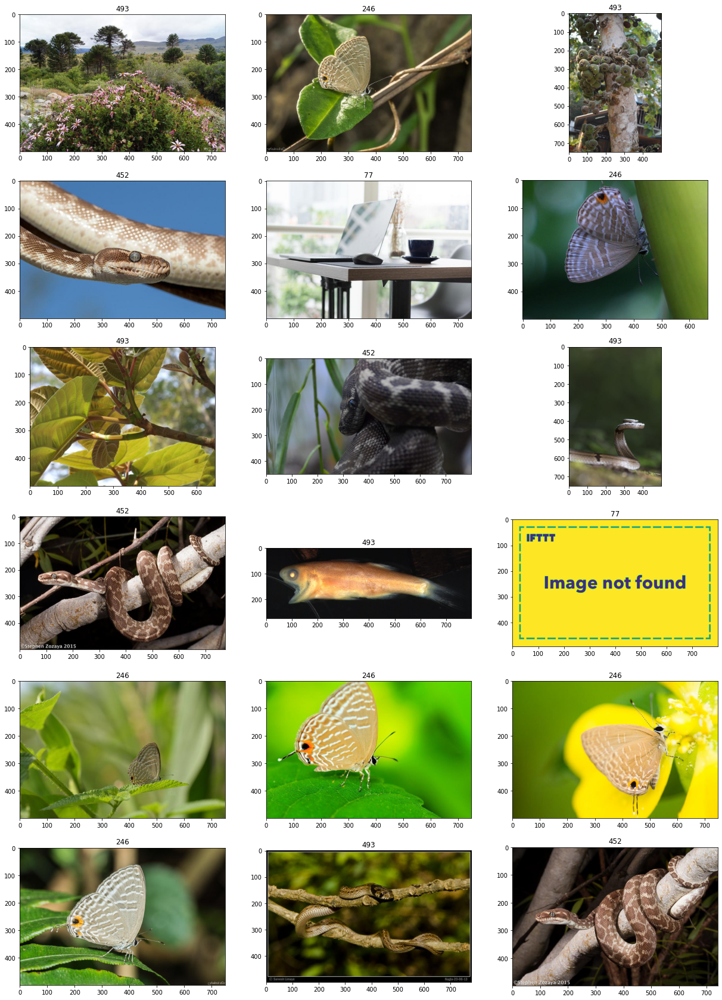

In [7]:
# load images
imgs = []
labels = []
for _, (img_path, class_id) in extra_classes_df[['image_path', 'class_id']].iterrows():
    imgs.append(plt.imread(DATA_DIR + TRAIN_SET_DIR + img_path))
    labels.append(class_id)

# show images
fig, axs = viz.create_fig(ncols=3, ntotal=len(imgs), colsize=7, rowsize=5)
for img, label, ax in zip(imgs, labels, axs):
    ax.imshow(img)
    ax.set(title=label)

## Number of Classes in Validation Subset After Removing Flickr Images

**Total number of classes in training dataset:**

In [8]:
# number of classes in train set
len(train_df.loc[train_df['subset'] == 'train', 'binomial'].drop_duplicates())

772

**Total number of classes in validation dataset:**

In [9]:
# number of classes in test set
len(train_df.loc[train_df['subset'] == 'val', 'binomial'].drop_duplicates())

772

**Total number of classes in training dataset after removing Flickr images:**

In [10]:
# number of classes in train set without flickr
len(train_df.loc[(train_df['subset'] == 'train') & (train_df['source'] != 'flickr'),
                 'binomial'].drop_duplicates())

768

**Total number of classes in validation dataset after removing Flickr images:**

In [11]:
# number of classes in valid set without flickr
len(train_df.loc[(train_df['subset'] == 'val') & (train_df['source'] != 'flickr'),
                 'binomial'].drop_duplicates())

733

## Estimating Percentage of Noisy Images in Flickr

Workflow:
1. Iteratively sample 100 images and manually count noisy images. Repeat 20 times.
2. After creating 20 count samples compute confidence interval using Student's t-distribution.

In [12]:
import matplotlib.pyplot as plt

from src.utils import visualization as viz


def plot_images(sample):
    fig, axs = viz.create_fig(ncols=3, ntotal=len(sample))

    for idx, ax in zip(sample.index, axs):
        row = sample.loc[idx]
        img = plt.imread(DATA_DIR + 'train/' + row['image_path'])
        species = row['binomial']

        ax.imshow(img)  # aspect='auto'
        ax.set_title(f'{species}', fontsize=14)
        ax.axis('off')


# get dataframe with Flikr images
flickr_df = train_df.loc[train_df['source'] == 'flickr']

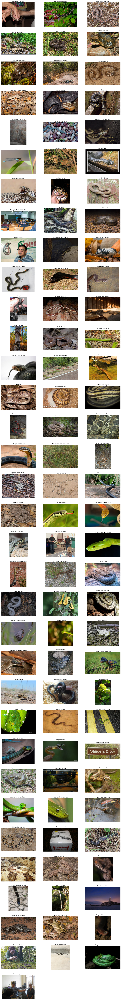

In [13]:
sample = flickr_df.sample(100)
plot_images(sample)

### Compute Confidence Interval Estimate of Noisy Images in Flickr using Student's t-distribution

In [14]:
# each sample is a count of noisy images in Flickr dataset
# samples were created by manually selecting noisy images in ten 100-sample groups
sample_counts = [7, 9, 11, 7, 14, 17, 10, 10, 12, 9]

In [15]:
import numpy as np
from scipy import stats

samples = np.array(sample_counts) / 100
n = len(samples)
df = n - 1
cv = stats.t.ppf(1 - 0.025, df)

mean = np.mean(samples)
margin_error = cv * np.var(samples, ddof=1) / np.sqrt(n)
print(f'Confidence interval\n<{mean - margin_error:.1%}; {mean + margin_error:.1%}>')

Confidence interval
<10.5%; 10.7%>
